In [78]:
import mrcfile
import numpy as np
import math
import sys, copy, os
from numpy.ma.core import where
from scipy.ndimage.measurements import label, maximum_position
from skimage import feature, io, color
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
from scipy import ndimage as ndi

from skimage import morphology
from skimage.feature import peak_local_max
from skimage.segmentation import watershed
import imutils
import pandas as pd 
from mpl_toolkits.mplot3d import Axes3D

"""
1. Import tomogram data
"""
filename = "session1/tomo01_b8_bp100-10000"
#filename= "20220222_Baker/tomo07_b8_bp10000-500"
#filename = "20220307_Baker/tomo8_b8_bp10000-500"
#filename = "session1/tomo20_b8_bp100-10000"

file = mrcfile.open("./raw/"+filename+".mrc")

vox_size = file.voxel_size.view((file.voxel_size.dtype[0], len(file.voxel_size.dtype.names)))
vox_size = vox_size[0]
print(vox_size)
#file.print_header()

#print out dimensions of tomogram
print("Tomogram dimensions (Z,Y,X) = ",file.data.shape)

#copy tomogram data
data = copy.deepcopy(file.data) * -1 #copy data and invert intensities

file.close()

"""
2. Normalise intensity values 
"""

def normalise_data(data, plthist=False):
    print("Normalising data...")
    data1d = data.flatten() #turning mrcfile into 1d array

    #calculating statistics
    mean = np.mean(data1d)
    stdev = np.std(data1d)

    data = (data - mean)/stdev

    print("Normalised.")

    if(plthist):
        hist_data2 = data.flatten() #turning mrcfile into 1d array for histogram plotting

        hist2 = plt.figure()
        plt.hist(hist_data2, bins = 100)
        plt.xlabel('Intensity')
        plt.ylabel('Frequency')
        plt.xlim([-5, 5])
        plt.title('Histogram of voxel intensities')
        plt.grid(True)
        plt.show()

    return data





11.183997
Tomogram dimensions (Z,Y,X) =  (81, 463, 480)


In [79]:
"""
High pass filtering
"""
# Before

#compute ND-FFT


def compute_edf(data):
    z, y, x = np.indices(data.shape)

    #find center of image
    center = np.asarray(data.shape)
    center = center/2 
    center = center.astype(int)

    edf = np.sqrt((x-center[2])**2 + (y-center[1])**2 + (z-center[0])**2) #Euclidean distance field

    return edf, center

def compute_edf2d(data):
    y, x = np.indices(data.shape)

    #find center of image
    center = np.asarray(data.shape)
    center = center/2 
    center = center.astype(int)

    edf = np.sqrt((x-center[1])**2 + (y-center[0])**2) #Euclidean distance field

    return edf, center
    

def highpass_step(data, f, pltfts=False, pltmask=False):
    data_freq = np.fft.fftn(data) #FT of 3D tomogram
    data_fshift = np.fft.fftshift(data_freq)

    edf, center = compute_edf(data_fshift)
    cent_slice = center[0]

    if(pltfts):
        plt.figure()
        plt.subplot(121)
        plt.imshow(20*np.log(np.abs(data_freq[cent_slice,:,:])),cmap='gray')

        plt.subplot(122)
        plt.imshow(20*np.log(np.abs(data_fshift[cent_slice,:,:])),cmap='gray')

        plt.title(f'FFT, central z-slice = {cent_slice}')
        plt.show()

    mask = edf > f #filter
    #mask = mask.astype(int)
    
    data_fshift = data_fshift * mask
    
    if(pltmask):
        plt.figure()
        plt.subplot(121)
        plt.imshow(mask[cent_slice,:,:],cmap='gray')

        plt.subplot(122)
        plt.imshow( (20*np.log10(0.01+np.abs(data_fshift[cent_slice,:,:]))),cmap='gray')
        plt.show()

    data_filt = np.real(np.fft.ifftn(np.fft.ifftshift(data_fshift)))
    
    return data_filt

def highpass_gauss(data, f, pltfts=False, pltmask=False):
    data_freq = np.fft.fftn(data) #FT of 3D tomogram
    data_fshift = np.fft.fftshift(data_freq)

    edf, center = compute_edf(data_fshift)
    cent_slice = center[0]

    if(pltfts):
        plt.figure()
        plt.subplot(121)
        plt.imshow(20*np.log(np.abs(data_freq[cent_slice,:,:])),cmap='gray')

        plt.subplot(122)
        plt.imshow(20*np.log(np.abs(data_fshift[cent_slice,:,:])),cmap='gray')
        plt.title(f'FFT, central z-slice = {cent_slice}')
        plt.show()
    
    gauss = 1 - np.exp(-edf/f**2)
    
    data_fshift = data_fshift * gauss
    
    if(pltmask):
        plt.figure()
        plt.subplot(121)
        plt.imshow(gauss[cent_slice,:,:],cmap='gray')

        plt.subplot(122)
        plt.imshow( (20*np.log10(0.01+np.abs(data_fshift[cent_slice,:,:]))),cmap='gray')
        plt.show()

    data_filt = np.real(np.fft.ifftn(np.fft.ifftshift(data_fshift)))
    
    return data_filt

def highpass_butter(data, f, n, pltfts=False, pltmask=False):
    """
    data = data
    f = frequency cut-off
    n = steepness
    """
    data_freq = np.fft.fftn(data) #FT of 3D tomogram
    data_fshift = np.fft.fftshift(data_freq)

    edf, center = compute_edf(data_fshift)
    cent_slice = center[0]

    if(pltfts):
        plt.figure()
        plt.subplot(121)
        plt.imshow(20*np.log(np.abs(data_freq[cent_slice,:,:])),cmap='gray')

        plt.subplot(122)
        plt.imshow(20*np.log(np.abs(data_fshift[cent_slice,:,:])),cmap='gray')
        plt.title(f'FFT, central z-slice = {cent_slice}')
        plt.show()

    butter = 1 - (1/((1+(edf/f))**(2*n))) #filter
    
    data_fshift = data_fshift * butter
    
    if(pltmask):
        plt.figure()
        plt.subplot(121)
        plt.imshow(butter[cent_slice,:,:],cmap='gray')

        plt.subplot(122)
        plt.imshow( (20*np.log10(0.01+np.abs(data_fshift[cent_slice,:,:]))),cmap='gray')
        plt.show()

    data_filt = np.real(np.fft.ifftn(np.fft.ifftshift(data_fshift)))
    
    return data_filt


f = 15
n = 100
_, center = compute_edf(data)
cent_slice = center[0]
#print(cent_slice)
pltfts = True
pltmask = True


data = normalise_data(data)
# data_filt = highpass_step(data, f, pltfts, pltmask)
# # data_filt = normalise_data(data_filt)

# data_filt1 = highpass_gauss(data, f/4, pltmask=pltmask)
# # data_filt1 = normalise_data(data_filt1)

# data_filt2 = highpass_butter(data, f*300, n, pltmask=pltmask)
# # data_filt2 = normalise_data(data_filt2)



#slice = cent_slice
slice=0
#slice = data.shape[0]-1


proj_o = data[slice,:,:] #original projection
# proj = data_filt[slice,:,:] #filtered projection
# proj1 = data_filt1[slice,:,:]
# proj2 = data_filt2[slice,:,:]

# fig, ax = plt.subplots(2,2, figsize=(12,12))
# ax[0,0].imshow(proj_o, cmap='gray')
# ax[0,0].set_title('original')
# ax[0,0].invert_yaxis()

# ax[0,1].imshow(proj, cmap='gray')
# ax[0,1].set_title('step')
# ax[0,1].invert_yaxis()

# ax[1,0].imshow(proj1, cmap='gray')
# ax[1,0].set_title('gauss')
# ax[1,0].invert_yaxis()

# ax[1,1].imshow(proj2, cmap='gray')
# ax[1,1].set_title('butter')
# ax[1,1].invert_yaxis()
# plt.show()

# After

Normalising data...
Normalised.


Text(0.5, 1.0, 'thres_LoG')

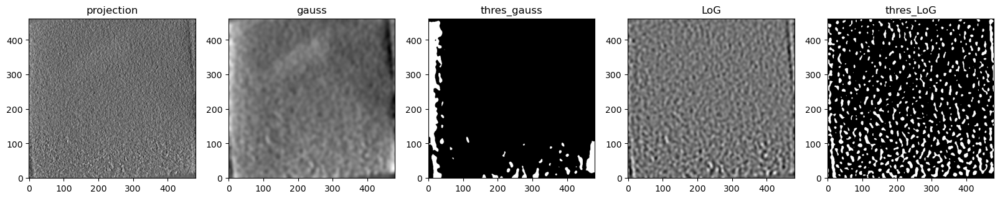

In [80]:
"""
LoG then Thresholding
"""

def threshold_range(proj, min=0, max=3, int=0.1, plot=True):

    print('Thresholding...')
    
    sigma = np.arange(min,max,int)
    y, x = proj.shape
    
    thres = {}
    
    for i, s in enumerate(sigma):
        thres[s] = (proj > s)
        thres[s] = thres[s].astype(bool)

    if(plot):
        fig1, ax1 = plt.subplots(nrows=len(sigma)+1, ncols=1, figsize = (7,5*len(sigma)+1))

        ax1[0].imshow(proj,cmap='gray')
        ax1[0].invert_yaxis()
        ax1[0].set_title('projection')

        for i, s in enumerate(sigma):
            ax1[i+1].imshow(thres[s],cmap='gray')
            ax1[i+1].invert_yaxis()
            ax1[i+1].set_title(f'threshold = {s}')

        fig1.suptitle('Thresholding results')

        fig1.tight_layout()
        plt.show()
    
    return thres, sigma

def threshold(proj, value=0.2, plot=False):
    thres = (proj > value)
    thres = thres.astype(bool)

    if(plot):
        fig1, ax1 = plt.subplots(nrows=1, ncols=2, figsize = (10,20))

        ax1[0].imshow(proj,cmap='gray')
        ax1[0].invert_yaxis()
        ax1[0].set_title('projection')
        
        ax1[1].imshow(thres, cmap='gray')
        ax1[1].invert_yaxis()
        ax1[1].set_title(f'threshold = {value}')

        fig1.tight_layout()
        plt.show()
    
    return thres

gauss = ndi.gaussian_filter(proj_o, sigma=5)
LoG = -ndi.gaussian_laplace(proj_o, sigma=5)

thres_gauss = threshold(gauss, value=0.25, plot=False)
thres_LoG = threshold(LoG, value=0.00, plot=False)


fig, ax = plt.subplots(nrows=1, ncols=5, figsize = (20,100))
ax[0].imshow(proj_o,cmap='gray')
ax[0].invert_yaxis()
ax[0].set_title('projection')

ax[1].imshow(gauss,cmap='gray')
ax[1].invert_yaxis()
ax[1].set_title('gauss')

ax[2].imshow(thres_gauss,cmap='gray')
ax[2].invert_yaxis()
ax[2].set_title('thres_gauss')

ax[3].imshow(LoG,cmap='gray')
ax[3].invert_yaxis()
ax[3].set_title('LoG')

ax[4].imshow(thres_LoG,cmap='gray')
ax[4].invert_yaxis()
ax[4].set_title('thres_LoG')



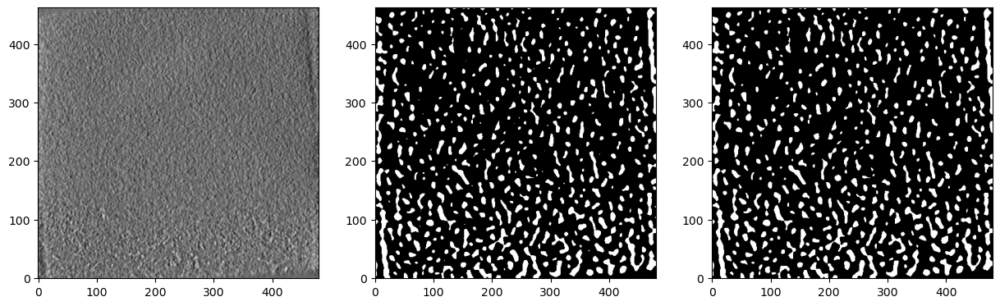

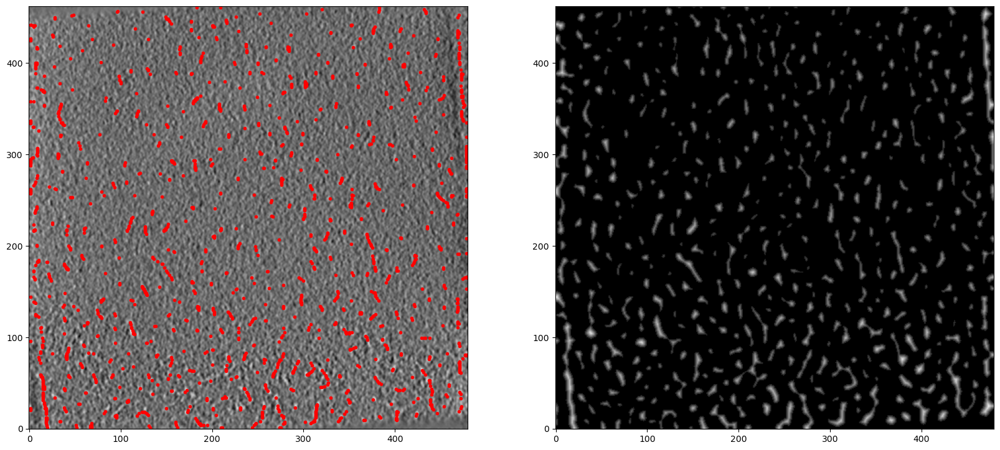

coords_filter.shape =  (497, 2)
1174 peak(s) too close to edge
Sampling from 497 peaks
Creating plot...


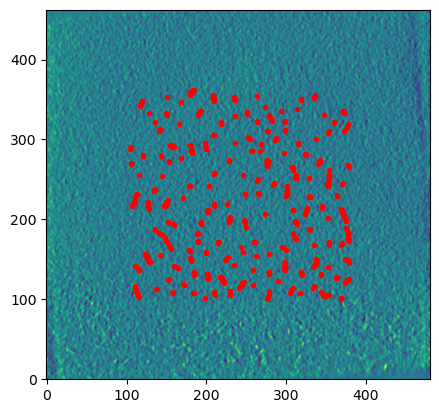

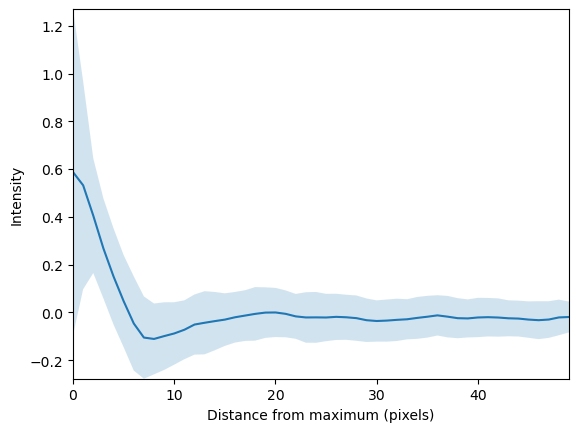

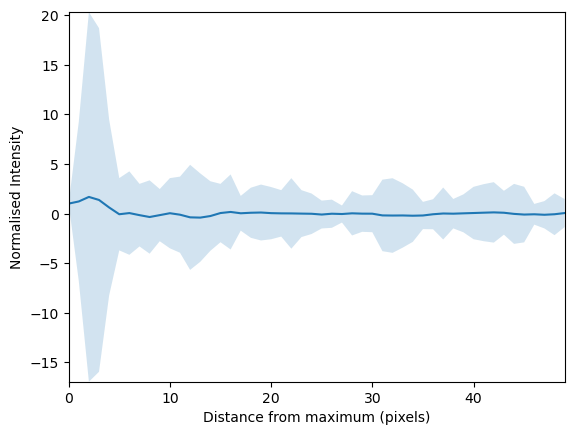

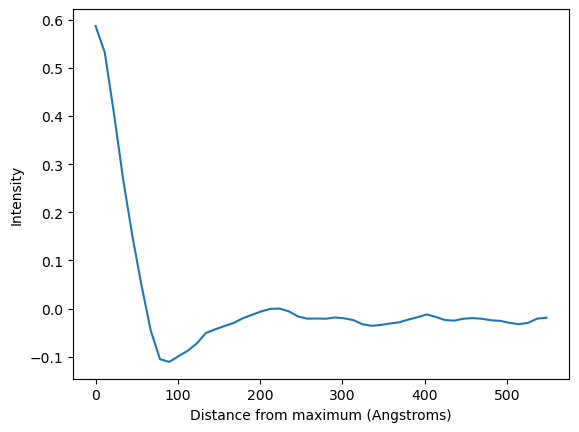

In [81]:
"""
Removing small objects
"""

from skimage import morphology
import plotly.graph_objects as go
import plotly.io as pio
from lib.analysis import *
pio.renderers.default = "notebook"

##import scipy

def remove_small_obj(thres, img, minsize, plot=False):
    thres_img = thres
    cleaned = morphology.remove_small_objects(thres_img, min_size = minsize)

    if(plot):
        fig, ax = plt.subplots(1, 3, figsize=(15,5))

        ax[0].imshow(img, cmap='gray')
        ax[0].invert_yaxis()

        ax[1].imshow(thres_img, cmap='gray')
        ax[1].invert_yaxis()

        ax[2].imshow(cleaned, cmap='gray')
        ax[2].invert_yaxis()
        plt.show()

    return cleaned

thres_img = thres_LoG
minsize = 10
plot = True
cleaned = remove_small_obj(thres_img, proj_o, minsize, plot)

#TODO — fill holes

distance = ndi.distance_transform_edt(cleaned) #Euclidean distance transform
distance_plot = copy.deepcopy(distance)
coords = peak_local_max(distance,  footprint = np.ones((3,3)), labels=thres_img, threshold_abs=2)
y = coords[:,0]
x = coords[:,1]

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(20,10))
ax[0].imshow(proj_o,cmap='gray')
ax[0].plot(x,y,'r.')
ax[0].invert_yaxis()

ax[1].imshow(distance_plot,cmap='gray')
#ax[1].plot(x,y,'r.')
ax[1].invert_yaxis()
plt.show()

xx, yy = np.mgrid[0:distance.shape[0],0:distance.shape[1]]

fig = go.Figure(data=[go.Surface(z=distance_plot)])
fig.show()

filename = 'session1/test'
gendists = GenerateDistributions(proj_o,coords,r=50,filename=filename, clust_av=True, pl_cluster=True)

plt.figure()
plt.plot(gendists.x_radav*vox_size,gendists.dropletmean)
plt.xlabel('Distance from maximum (Angstroms)')
plt.ylabel('Intensity')
plt.show()



/Users/eugene/opt/miniconda3/lib/python3.9/site-packages/skimage/color/colorlabel.py:113: UserWarning: Negative intensities in `image` are not supported
  return _label2rgb_overlay(label, image, colors, alpha, bg_label,
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


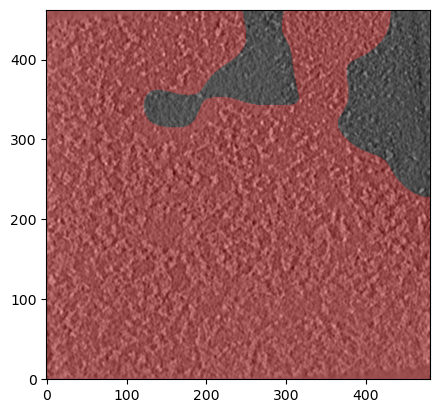

In [33]:
"""
Coarse mapping of area with protein
"""

def coarse_map(thres, std, threshold, plot=False):
    thres_float = thres.astype(np.float32)
    blur = ndi.gaussian_filter(thres_float,std)
    blur = blur/np.amax(blur)
    maskarea = (blur > threshold)
    
    if(plot):
        norm_proj = cv2.normalize(proj_o, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
        
        plt.figure()
        plt.imshow(color.label2rgb(maskarea, norm_proj, bg_label=0))
        plt.gca().invert_yaxis()
        plt.show
        
    return blur, maskarea

std = 20
value = 0.28
plot=True
thresimg=cleaned
blur, maskarea = coarse_map(thresimg, std, value, plot)

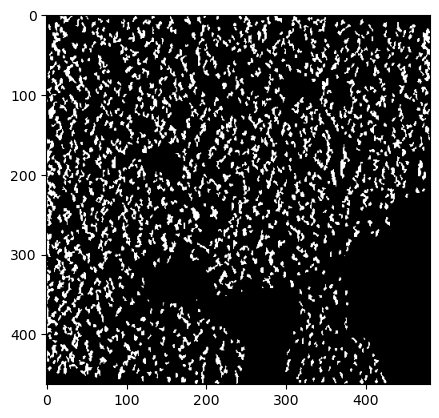

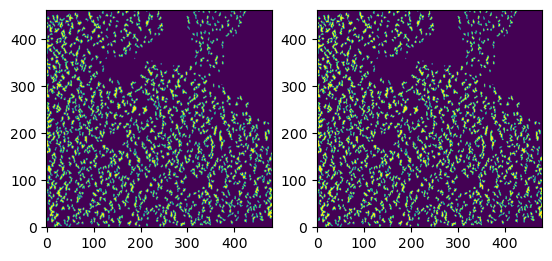

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


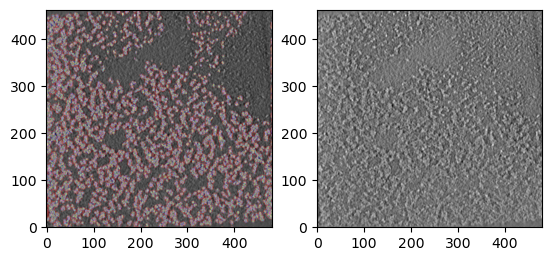

In [34]:
"""
Peak picking and segmentation
"""

#Threshold processed image
img_processed = blur*proj_o
thres1 = maskarea*cleaned
# thres1 = proj*maskarea >0.8

plt.figure()
plt.imshow(thres1, cmap='gray')
plt.show()

def segmentation(thres):
    distance = ndi.distance_transform_edt(thres) #Euclidean distance transform
    coords = peak_local_max(distance,  footprint = np.ones((3,3)), labels=thres)
    mask_a = np.zeros(distance.shape, dtype=bool)
    mask_a[tuple(coords.T)] = True
    markers, _ = ndi.label(mask_a)
    labels = watershed(-distance, markers, mask=thres) #find labels/segments

    return labels, coords

def lowpass_butter(data, f, n, pltfts=False, pltmask=False):
    """
    data = data
    f = frequency cut-off
    n = steepness
    """
    data_freq = np.fft.fftn(data) #FT of 3D tomogram
    data_fshift = np.fft.fftshift(data_freq)

    edf, center = compute_edf2d(data_fshift)
    cent_slice = center[0]

    if(pltfts):
        plt.figure()
        plt.subplot(121)
        plt.imshow(20*np.log(np.abs(data_freq[cent_slice,:,:])),cmap='gray')

        plt.subplot(122)
        plt.imshow(20*np.log(np.abs(data_fshift[cent_slice,:,:])),cmap='gray')
        plt.gca().invert_yaxis()
        plt.title(f'FFT, central z-slice = {cent_slice}')
        plt.show()

    butter = (1/((1+(edf/f))**(2*n))) #filter
    
    data_fshift = data_fshift * butter
    
    if(pltmask):
        plt.figure()
        plt.subplot(121)
        plt.imshow(butter[cent_slice,:,:],cmap='gray')

        plt.subplot(122)
        plt.imshow( (20*np.log10(0.01+np.abs(data_fshift[cent_slice,:,:]))),cmap='gray')
        plt.gca().invert_yaxis()
        plt.show()

    data_filt = np.real(np.fft.ifftn(np.fft.ifftshift(data_fshift)))
    
    return data_filt

f = 2500
n = 1

labels, coords =  segmentation(thres1)
labels = labels >0
labels_filt = lowpass_butter(labels,f,n)
#labels_mask = labels_filt>1
labels_filt = labels_filt*255/np.max(labels_filt)
labels_filt = labels_filt.astype(np.uint8)
plt.figure()
plt.subplot(121)
plt.imshow(labels_filt)
plt.gca().invert_yaxis()
plt.subplot(122)
plt.imshow(labels)
plt.gca().invert_yaxis()
plt.show()

norm_proj = cv2.normalize(proj_o, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
plt.figure()
plt.subplot(121)
plt.imshow(color.label2rgb(labels_filt, norm_proj,bg_label=0))
plt.gca().invert_yaxis()
plt.subplot(122)
plt.imshow(proj_o, cmap='gray')
plt.gca().invert_yaxis()
plt.show()



coords_filter.shape =  (3992, 2)
4133 peak(s) too close to edge
Sampling from 3992 peaks
Creating plot...


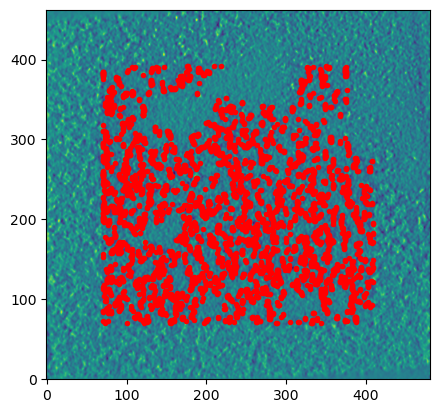

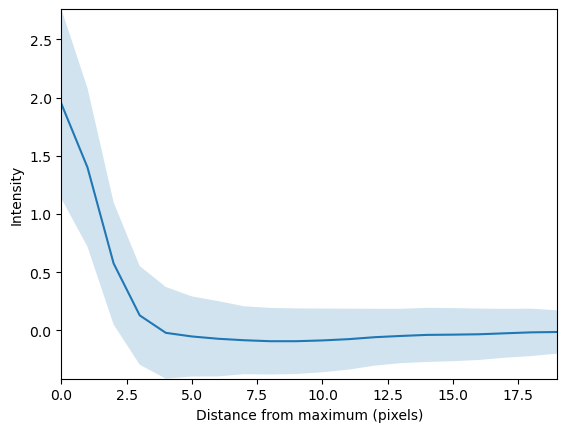

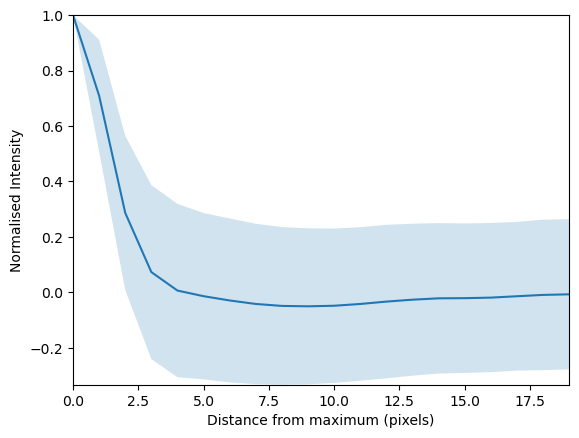

In [10]:
from analysis import ImageProcessing, GenerateDistributions

img = proj_o
peaklist = coords
r = 20
dtheta = 1

#filename = "session1/tomo1"
slice = slice

pl_radav = False
clust_av = True
pl_cluster = True
save=True

imgproc = ImageProcessing(thres1,filename,slice=slice)
gen_dists = GenerateDistributions(img,peaklist,r,dtheta,filename,
    pl_radav=pl_radav,
    clust_av=clust_av,
    pl_cluster=pl_cluster,
    save=save,
    slice=slice)

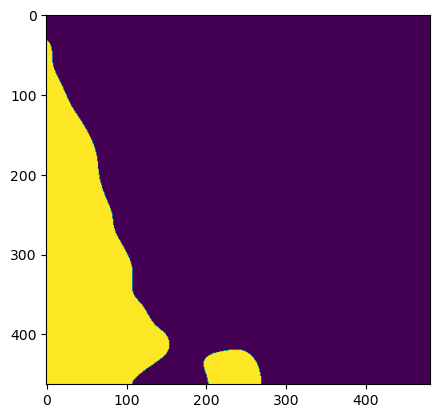

In [ ]:
file = "./masks/session1/tomo20_b8_bp100-10000_coarsemap.npy"
file2 = './masks/session1/tomo20_b8_bp100-10000.'
arr = np.load(file)

plt.imshow(arr[1,:,:])
plt.show()

In [2]:
import mrcfile 
from analysis import ImageProcessing, GenerateDistributions
import mrcfile
import numpy as np
import sys, copy, os
from numpy.ma.core import where
from scipy.ndimage.measurements import label, maximum_position
from skimage import feature, io, color
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import cv2
from scipy import ndimage as ndi

from skimage import morphology
from skimage.feature import peak_local_max
from skimage.segmentation import watershed
import imutils
import pandas as pd 
from crop import save_density

def normalise_data(data, plthist=False):
    print("Normalising data...")
    data1d = data.flatten() #turning mrcfile into 1d array

    #calculating statistics
    mean = np.mean(data1d)
    stdev = np.std(data1d)

    data = (data - mean)/stdev

    print("Normalised.")

    if(plthist):
        hist_data2 = data.flatten() #turning mrcfile into 1d array for histogram plotting

        hist2 = plt.figure()
        plt.hist(hist_data2, bins = 100)
        plt.xlabel('Intensity')
        plt.ylabel('Frequency')
        plt.xlim([-5, 5])
        plt.title('Histogram of voxel intensities')
        plt.grid(True)
        plt.show()

    return data

#loading files
##initialise names
rawtomoname = 'raw/20220307_Baker/tomo8_b8_bp10000-500_s81-101.mrc' #can become sys.arg argument

rawtomoname = rawtomoname.split('.')[0]
session = rawtomoname.split('/')[-2]
tomo = rawtomoname.split('/')[-1]

coarse_mapname = f'data/masks/{session}/{tomo}_coarsemap.npy'
maskname = f'data/masks/{session}/{tomo}_mask.npy'

#load files
with mrcfile.open(f'{rawtomoname}.mrc') as mrc:
    rawtomo = copy.deepcopy(mrc.data) * -1
    voxel_size = mrc.voxel_size
    print(voxel_size)
print(rawtomo.shape)
normtomo=normalise_data(rawtomo)

coarsemap = np.load(coarse_mapname)
mask = np.load(maskname)
mask = mask.astype(bool)
print(mask.shape)
f=1500

######## segmentation
plot = True

def segmentation_slices(mask,rawtomoname,rawtomo,f,plot=False):
    for i, zslice in enumerate(mask):
        img_proc = ImageProcessing(zslice,rawtomoname,slice=i,f=f)
        proj = rawtomo[i,:,:]
        labels = img_proc.labels_filt > 0
        labels = labels.astype(float)
        indices = np.where(labels==0)
        newtomo = rawtomo[i,:,:]
        newtomo[indices] = newtomo[indices]

        if(plot):
            norm_proj = cv2.normalize(proj, None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
            plt.figure()
            plt.subplot(131)
            plt.imshow(color.label2rgb(labels, norm_proj,bg_label=0))
            plt.gca().invert_yaxis()
            plt.subplot(132)
            plt.imshow(newtomo, cmap='gray')
            plt.gca().invert_yaxis()
            plt.subplot(133)
            plt.imshow(proj,cmap='gray')
            plt.gca().invert_yaxis()
            plt.show()
    
    return newtomo

#segmentation_slices(mask,rawtomoname,rawtomo,f,plot)


(8.848, 8.847999, 1.)
(20, 720, 511)
Normalising data...
Normalised.
(20, 720, 511)


(20, 720, 511)


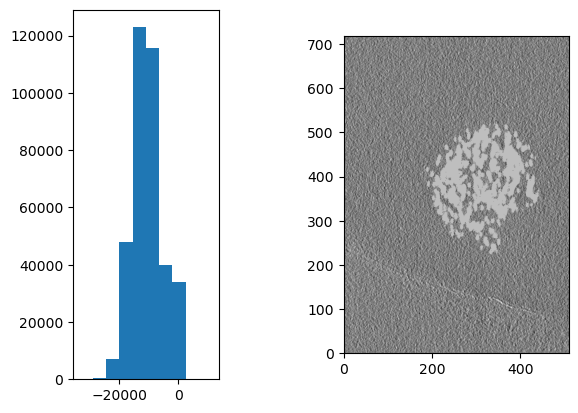

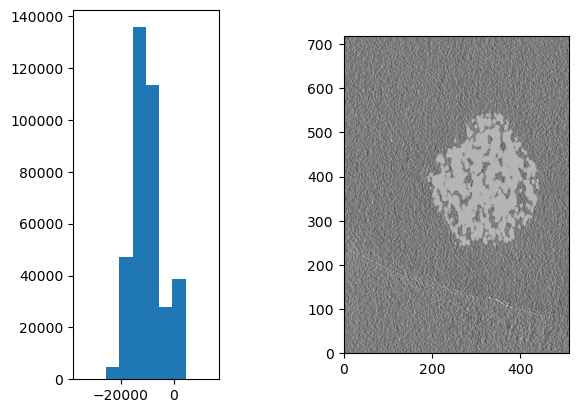

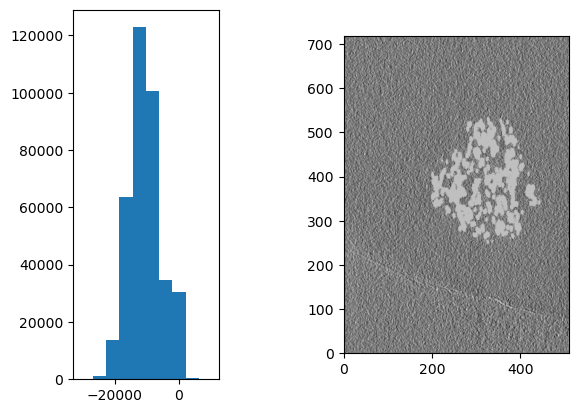

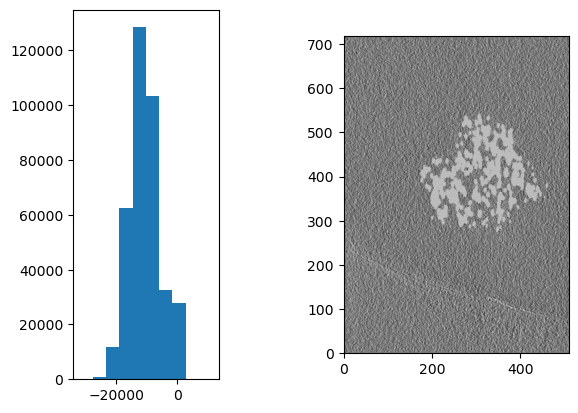

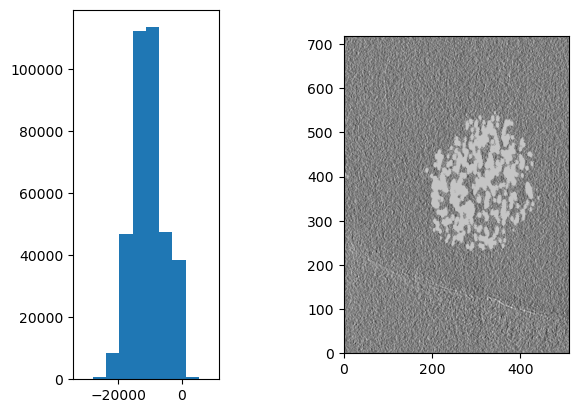

...

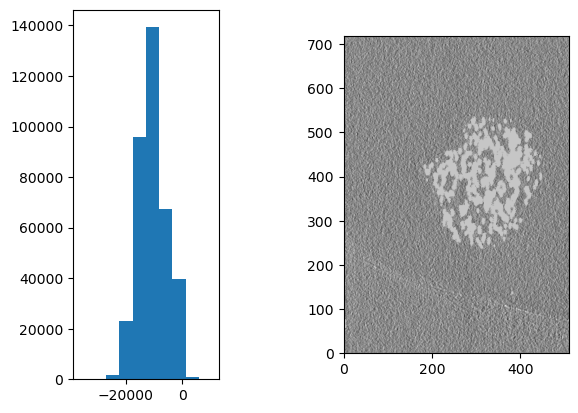

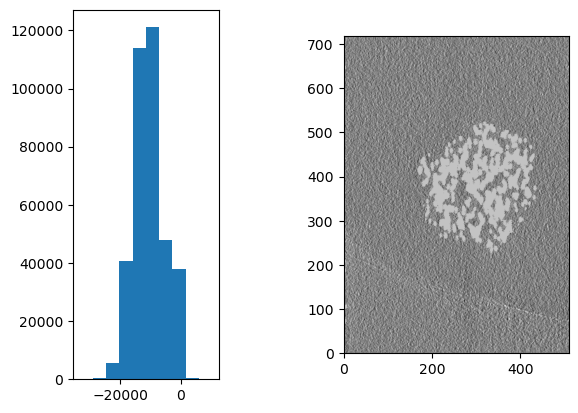

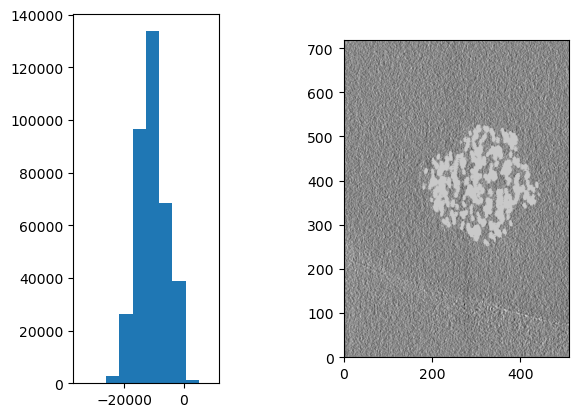

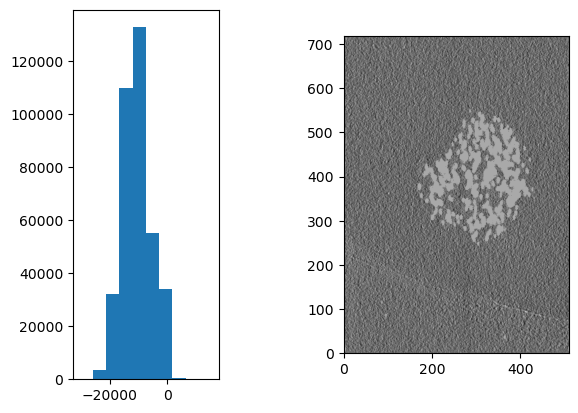

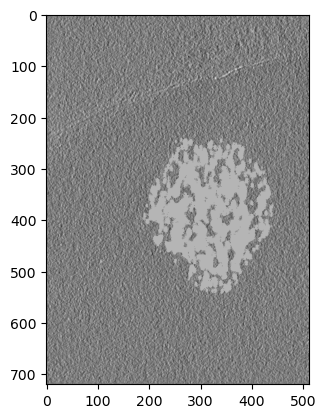

Saving mrc file ...
done


In [103]:

## creating segmented tomogram

tomo_segmented = np.zeros(mask.shape)
print(tomo_segmented.shape)

for i, zslice in enumerate(tomo_segmented):
    segmentname = f'data/segmentation/{session}/{tomo}/{i}_segments.npy'
    labels_filt = np.load(segmentname)
    labels = labels_filt > 0
    labels = labels.astype(float)
    indices = np.where(labels==0)
    newtomo = np.zeros_like(rawtomo[i,:,:])

    mean = np.mean(rawtomo)
    std = np.std(rawtomo)
    newtomo[indices] = rawtomo[i][indices]-2*std

    tomo_segmented[i] = copy.deepcopy(newtomo)
    
    if(plot):
        hist = tomo_segmented[i,:,:].flatten()

        plt.figure(131)
        plt.subplot(131)
        plt.hist(hist)
        plt.subplot(132)
        plt.imshow(labels,cmap='gray')
        plt.gca().invert_yaxis()
        plt.subplot(122)
        plt.imshow(tomo_segmented[i],cmap='gray')
        plt.gca().invert_yaxis()
        plt.show()
    
if(plot):
    plt.figure()
    plt.imshow(tomo_segmented[1,:,:],cmap='gray')
    plt.show()

if(os.path.exists(f'./data/segmentedtomos/{session}')==False):
    os.makedirs(f'./data/segmentedtomos/{session}')

outfilename = f'data/segmentedtomos/{session}/{tomo}_segmented.mrc'
save_density(tomo_segmented, voxel_size, outfilename)



In [ ]:

## calculating radial distributions
#load files

for i, zslice in enumerate(normtomo):
    img = zslice
    peaklist = np.load(f'data/peaklist/{session}/{tomo}/{i}_peaklist.npy')
    r = 20
    gen_dists = GenerateDistributions(img,peaklist,r,rawtomoname,slice=i)





20
(61428, 20)


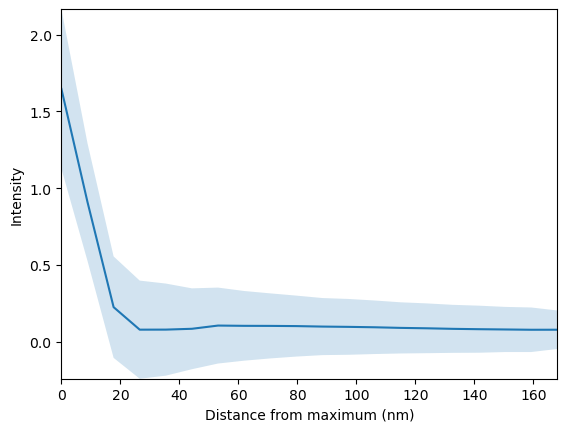

<class 'numpy.recarray'>


In [107]:
# plotting distributions
radavlist = np.load(f'data/radavdata/radav/{session}/{tomo}/0_radavlist.npy')
print(radavlist.shape[1])
for i in range(len(rawtomo)-1):
    radavlist_b = np.load(f'data/radavdata/radav/{session}/{tomo}/{i+1}_radavlist.npy')
    radavlist = np.vstack((radavlist,radavlist_b))

print(radavlist.shape)

dropletmean = np.mean(radavlist,axis=0)
dropletstd = np.std(radavlist,axis=0)

vox_size = voxel_size.view((voxel_size.dtype[0], len(voxel_size.dtype.names)))
vox_size = vox_size[0]

x_radav = np.arange(0,r,1)*vox_size

plt.figure()
plt.plot(x_radav,dropletmean)
plt.fill_between(x_radav,dropletmean - dropletstd, dropletmean+dropletstd, alpha=0.2)
plt.ylim([np.min(dropletmean-dropletstd),np.max(dropletmean+dropletstd)])
plt.xlim([0,np.max(x_radav)])
plt.xlabel('Distance from maximum (nm)')
plt.ylabel('Intensity')
plt.show()
print(type(voxel_size))

    

In [23]:
segments = np.load(f'data/segmentation/{session}/{tomo}/0_segments.npy')
protein_cont = np.count_nonzero(segments)/np.count_nonzero(coarsemap[0,:,:])
print(protein_cont)

0.5573397616594413


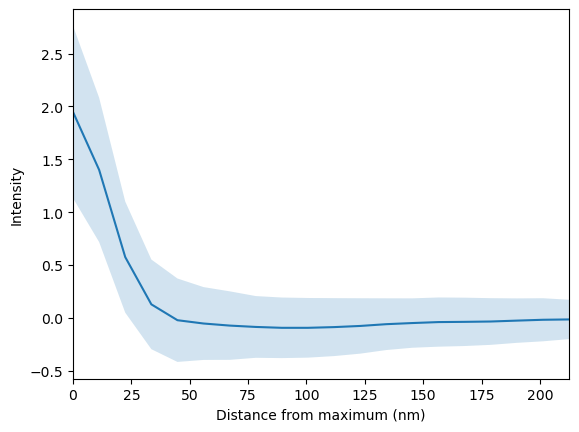

<class 'numpy.recarray'>


In [26]:
radavlist = np.load(f'data/radavdata/radav/session1/tomo01_b8_bp100-10000/40_radavlist.npy')
dropletmean = np.mean(radavlist,axis=0)
dropletstd = np.std(radavlist,axis=0)

voxsize=11.1

x_radav = np.arange(0,r,1)*vox_size

plt.figure()
plt.plot(x_radav,dropletmean)
plt.fill_between(x_radav,dropletmean - dropletstd, dropletmean+dropletstd, alpha=0.2)
#plt.ylim([np.min(dropletmean-dropletstd),np.max(dropletmean+dropletstd)])
plt.xlim([0,np.max(x_radav)])
plt.xlabel('Distance from maximum (nm)')
plt.ylabel('Intensity')
plt.show()
print(type(voxel_size))

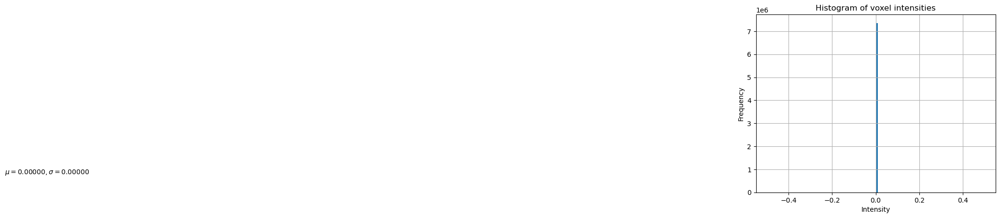

In [44]:
new_tomo = mrcfile.open(f'data/segmentedtomos/{session}/{tomo}_segmented.mrc')

mrcf = copy.deepcopy(new_tomo.data)

hist_data = mrcf.flatten()
mean = np.mean(hist_data)
std = np.std(hist_data)

hist1 = plt.figure()
plt.hist(hist_data, bins = 100)
plt.xlabel('Intensity')
plt.ylabel('Frequency')
plt.title('Histogram of voxel intensities')
plt.text(-4, 0.8*1e6, r'$\mu = %1.5f, \sigma = %1.5f$' %(mean,std))
plt.grid(True)
plt.show()


In [111]:
import os

list = os.listdir(f'data/radavdata/radav/{session}/{tomo}') # dir is your directory path
number_files = int(len(list)/2)
print(number_files)


20


Saving mrc file ...
done
Normalising data...
Normalised.
Saving mrc file ...
done
coords_filter.shape =  (2273, 2)
780 peak(s) too close to edge
Sampling from 2273 peaks
Creating plot...


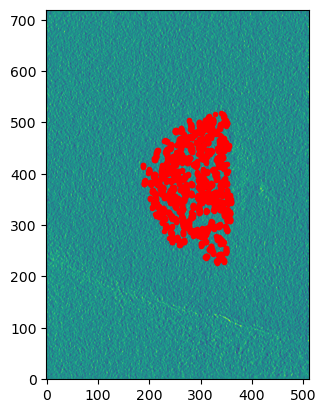

coords_filter.shape =  (2859, 2)
1172 peak(s) too close to edge
Sampling from 2859 peaks
Creating plot...


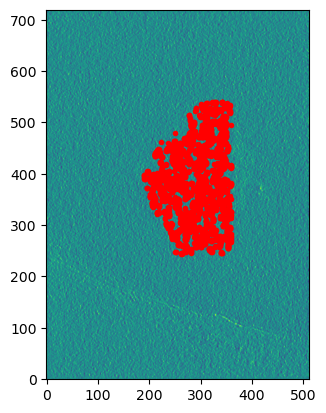

coords_filter.shape =  (2026, 2)
730 peak(s) too close to edge
Sampling from 2026 peaks
Creating plot...


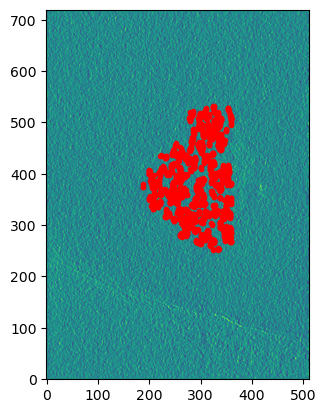

coords_filter.shape =  (1975, 2)
578 peak(s) too close to edge
Sampling from 1975 peaks
Creating plot...


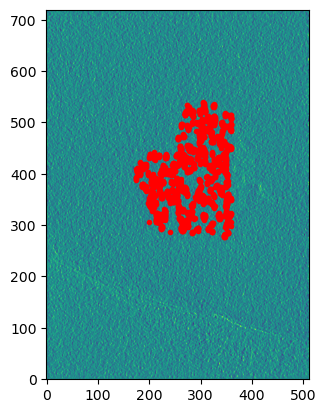

coords_filter.shape =  (2550, 2)
728 peak(s) too close to edge
Sampling from 2550 peaks
Creating plot...


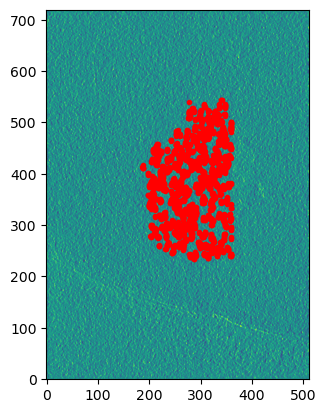

coords_filter.shape =  (1726, 2)
659 peak(s) too close to edge
Sampling from 1726 peaks
Creating plot...


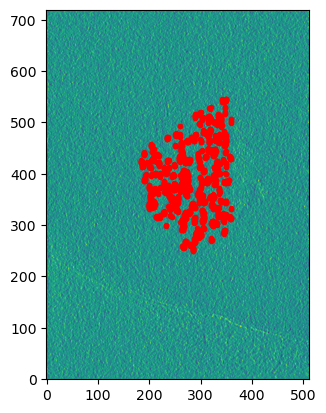

coords_filter.shape =  (2104, 2)
711 peak(s) too close to edge
Sampling from 2104 peaks
Creating plot...


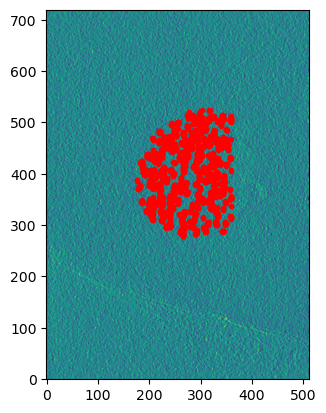

coords_filter.shape =  (2269, 2)
723 peak(s) too close to edge
Sampling from 2269 peaks
Creating plot...


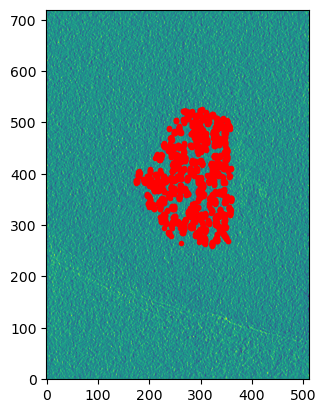

coords_filter.shape =  (2296, 2)
943 peak(s) too close to edge
Sampling from 2296 peaks
Creating plot...


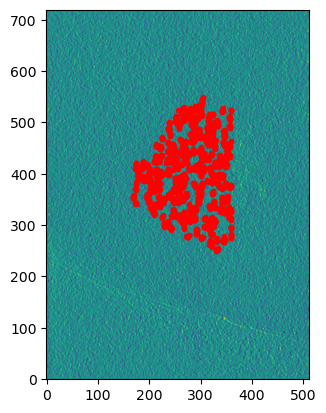

coords_filter.shape =  (2198, 2)
827 peak(s) too close to edge
Sampling from 2198 peaks
Creating plot...


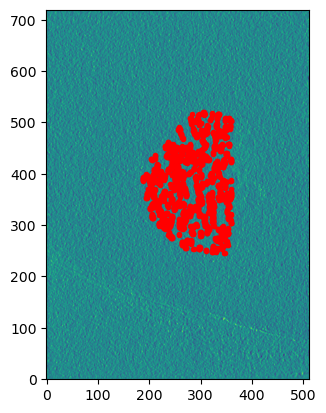

coords_filter.shape =  (2319, 2)
726 peak(s) too close to edge
Sampling from 2319 peaks
Creating plot...


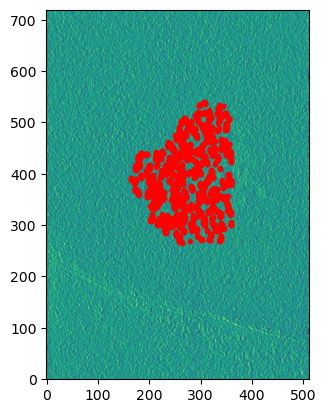

coords_filter.shape =  (2838, 2)
851 peak(s) too close to edge
Sampling from 2838 peaks
Creating plot...


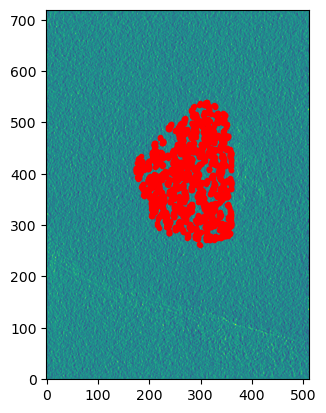

coords_filter.shape =  (1996, 2)
775 peak(s) too close to edge
Sampling from 1996 peaks
Creating plot...


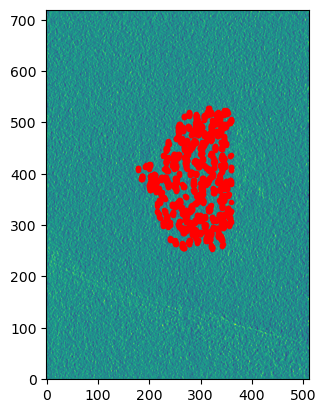

coords_filter.shape =  (2909, 2)
1145 peak(s) too close to edge
Sampling from 2909 peaks
Creating plot...


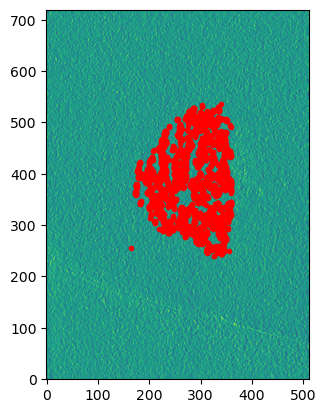

coords_filter.shape =  (2282, 2)
775 peak(s) too close to edge
Sampling from 2282 peaks
Creating plot...


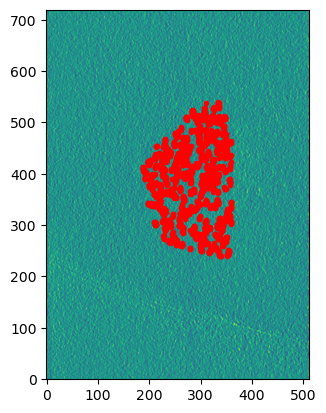

coords_filter.shape =  (2235, 2)
543 peak(s) too close to edge
Sampling from 2235 peaks
Creating plot...


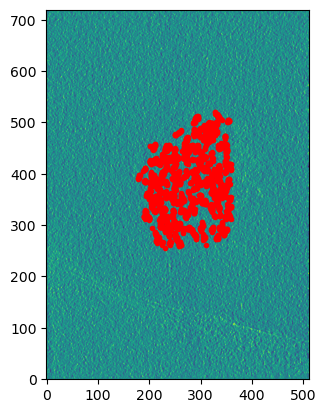

coords_filter.shape =  (2154, 2)
981 peak(s) too close to edge
Sampling from 2154 peaks
Creating plot...


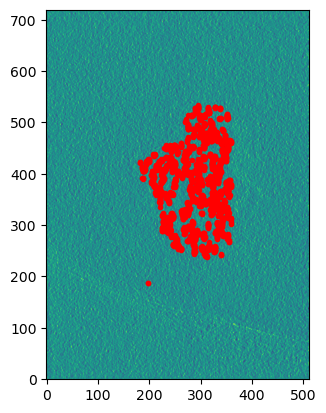

coords_filter.shape =  (2460, 2)
819 peak(s) too close to edge
Sampling from 2460 peaks
Creating plot...


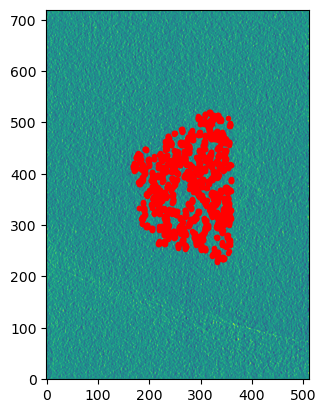

coords_filter.shape =  (2226, 2)
662 peak(s) too close to edge
Sampling from 2226 peaks
Creating plot...


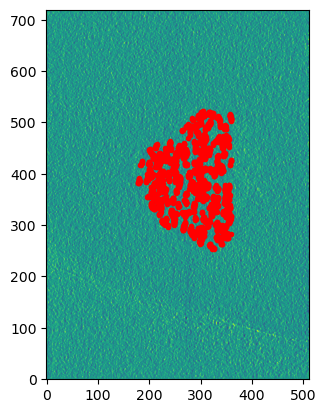

coords_filter.shape =  (2234, 2)
670 peak(s) too close to edge
Sampling from 2234 peaks
Creating plot...


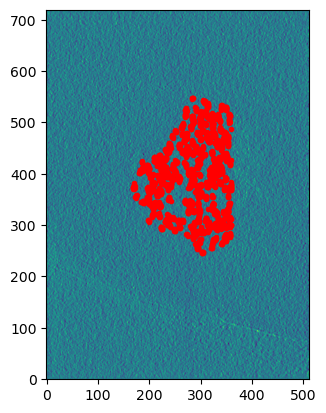

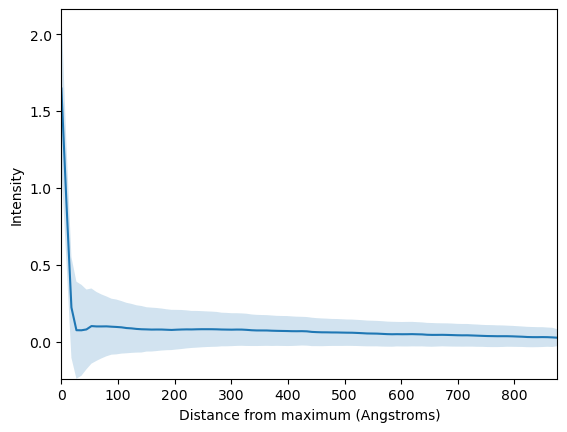

In [1]:
from lib.stacks_analysis import *

rawtomoname = 'raw/20220307_Baker/tomo8_b8_bp10000-500_s81-101.mrc' #can become sys.arg argument

analysis = analysis_stacks(rawtomoname, r=100)
plot = plotting(rawtomoname)

(8.848, 8.848, 8.848)
(20, 720, 511)
Normalising data...
Normalised.


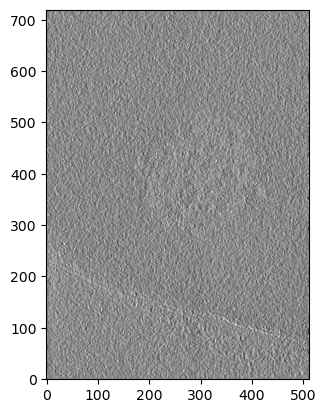

input dimensions for square mask (x1,x2,y1,y2)


/Users/eugene/opt/miniconda3/lib/python3.9/site-packages/skimage/color/colorlabel.py:113: UserWarning: Negative intensities in `image` are not supported
  return _label2rgb_overlay(label, image, colors, alpha, bg_label,
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


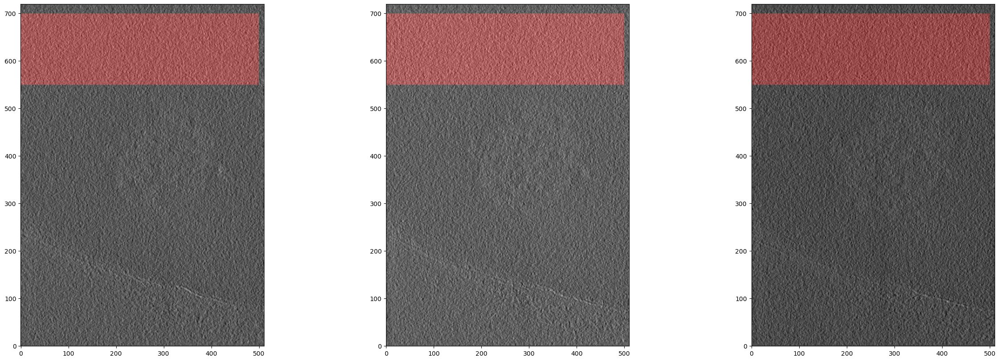

accept? (Y/N)
-0.012175788


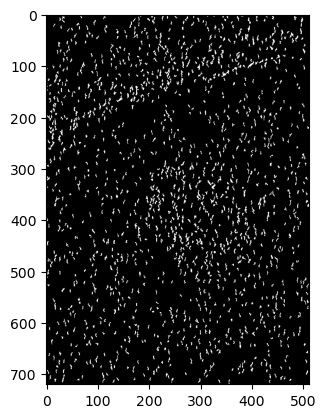

In [5]:
import mrcfile
import copy
from lib.analysis import *
import numpy as np
from skimage import color
import cv2

def make_square(normtomo):
    mid_zslice = int(normtomo.shape[0]/2)
    end_zslice = int(normtomo.shape[0])-1

    print('input dimensions for square mask (x1,x2,y1,y2)')
    dim = input()
    dim = dim.split(',')
    dim = list(map(int,dim))

    x1 = dim[0]
    x2 = dim[1]
    y1 = dim[2]
    y2 = dim[3]

    square = np.zeros_like(normtomo)
    square[:,y1:y2,x1:x2] = 1

    norm_start = cv2.normalize(normtomo[0,:,:], None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    norm_mid = cv2.normalize(normtomo[mid_zslice,:,:], None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)
    norm_end = cv2.normalize(normtomo[end_zslice,:,:], None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)

    fig, ax = plt.subplots(nrows=1,ncols=3,figsize=(30,10))
    ax[0].imshow(color.label2rgb(square[0,:,:], norm_start,bg_label=0))
    ax[0].invert_yaxis()
    ax[1].imshow(color.label2rgb(square[mid_zslice,:,:], norm_mid,bg_label=0))
    ax[1].invert_yaxis()
    ax[2].imshow(color.label2rgb(square[end_zslice,:,:],norm_end,bg_label=0))
    ax[2].invert_yaxis()
    plt.show()

    return dim,square

def baseline_correction(normtomo):
    mid_zslice = int(normtomo.shape[0]/2)

    plt.figure()
    plt.imshow(normtomo[mid_zslice,:,:],cmap='gray')
    plt.gca().invert_yaxis()
    plt.show()

    dim,square = make_square(normtomo)

    print('accept? (Y/N)')
    accept = input()
    while(not(accept == 'Y' or accept == 'N')):
        print('invalid input')
        accept = input()

    while(accept=='N'):
        dim = make_square(normtomo)

    x1 = dim[0]
    x2 = dim[1]
    y1 = dim[2]
    y2 = dim[3]

    baseline = np.mean(normtomo[:,y1:y2,x1:x2])

    return baseline, dim, square

#Baseline correction
rawtomoname = 'raw/20220307_Baker/tomo8_b8_bp10000-500_s81-101.mrc' #can become sys.arg argument

rawtomoname = rawtomoname.split('.')[0]
session = rawtomoname.split('/')[-2]
tomo = rawtomoname.split('/')[-1]

coarse_mapname = f'data/masks/{session}/{tomo}_coarsemap.npy'
maskname = f'data/masks/{session}/{tomo}_mask.npy'
threshedname = f'data/masks/{session}/{tomo}_threshraw.npy'

#load files
with mrcfile.open(f'{rawtomoname}.mrc') as mrc:
    rawtomo = copy.deepcopy(mrc.data) * -1
    voxel_size = mrc.voxel_size
    print(voxel_size)
print(rawtomo.shape)
normtomo=normalise_data(rawtomo)

coarsemap = np.load(coarse_mapname)
mask = np.load(maskname).astype(bool)
threshed = np.load(threshedname).astype(bool)

#########

baseline, dim, square = baseline_correction(normtomo)
print(baseline)

plt.figure()
plt.imshow(threshed[10,:,:], cmap='gray')
plt.show()
threshed_baseline = (threshed*square).astype(int)

for i, zslice in enumerate(threshed_baseline):
    img_proc = ImageProcessing(zslice,rawtomoname,slice=i,baseline=True)


In [ ]:

for i, zslice in enumerate(normtomo):
    img = zslice
    peaklist = np.load(f'data/peaklist/{session}/{tomo}/{i}_blinepeaklist.npy')
    gen_dists = GenerateDistributions(img,peaklist,r=100,rawtomoname,baseline=True,slice=i)



coords_filter.shape =  (206, 2)
2975 peak(s) too close to edge
Sampling from 206 peaks
Creating plot...


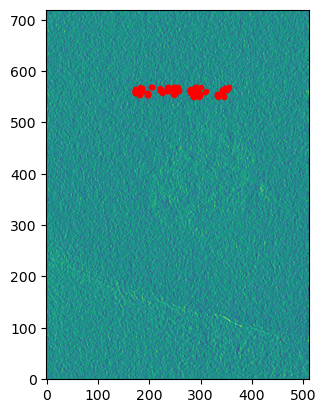

coords_filter.shape =  (204, 2)
3838 peak(s) too close to edge
Sampling from 204 peaks
Creating plot...


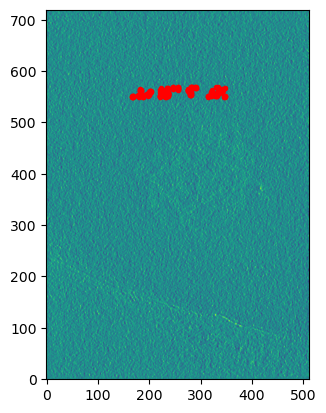

coords_filter.shape =  (120, 2)
2281 peak(s) too close to edge
Sampling from 120 peaks
Creating plot...


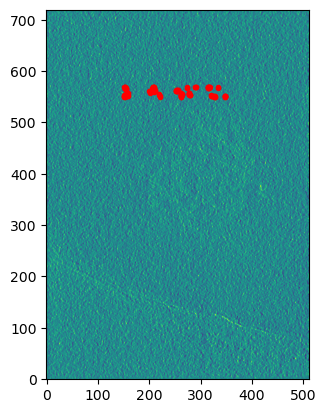

coords_filter.shape =  (169, 2)
2539 peak(s) too close to edge
Sampling from 169 peaks
Creating plot...


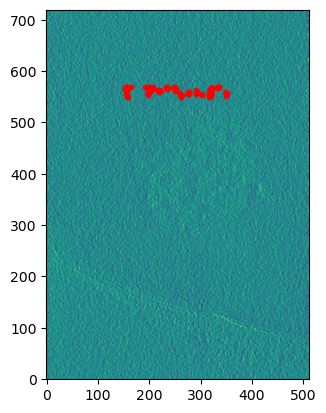

coords_filter.shape =  (187, 2)
2291 peak(s) too close to edge
Sampling from 187 peaks
Creating plot...


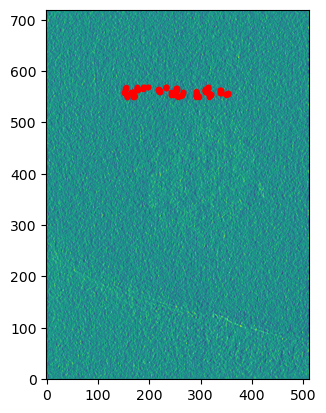

coords_filter.shape =  (155, 2)
1703 peak(s) too close to edge
Sampling from 155 peaks
Creating plot...


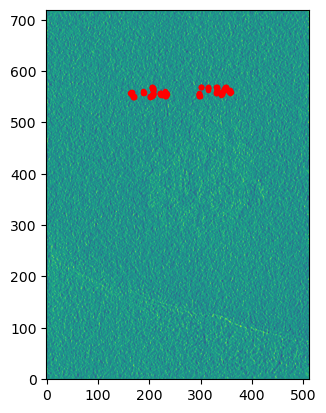

coords_filter.shape =  (111, 2)
2235 peak(s) too close to edge
Sampling from 111 peaks
Creating plot...


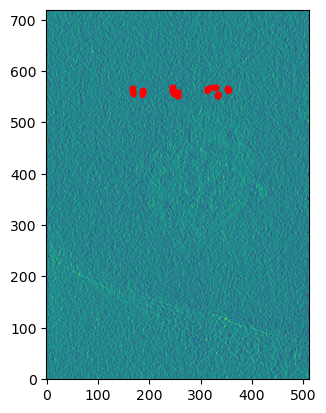

coords_filter.shape =  (136, 2)
2284 peak(s) too close to edge
Sampling from 136 peaks
Creating plot...


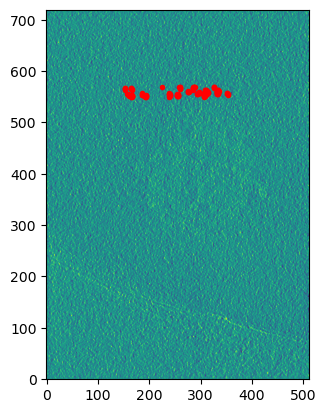

coords_filter.shape =  (158, 2)
2317 peak(s) too close to edge
Sampling from 158 peaks
Creating plot...


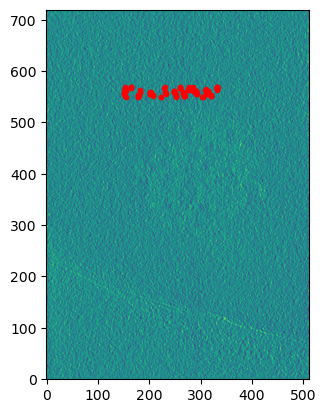

coords_filter.shape =  (104, 2)
2361 peak(s) too close to edge
Sampling from 104 peaks
Creating plot...


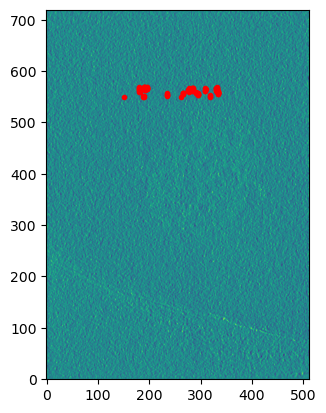

coords_filter.shape =  (111, 2)
2449 peak(s) too close to edge
Sampling from 111 peaks
Creating plot...


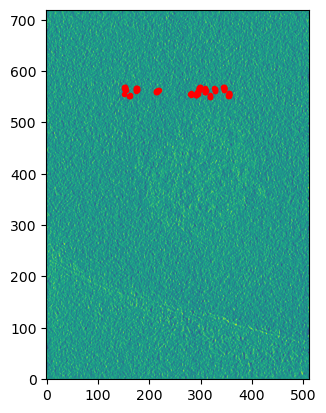

coords_filter.shape =  (177, 2)
3276 peak(s) too close to edge
Sampling from 177 peaks
Creating plot...


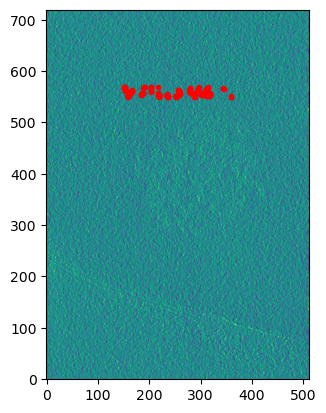

coords_filter.shape =  (110, 2)
2481 peak(s) too close to edge
Sampling from 110 peaks
Creating plot...


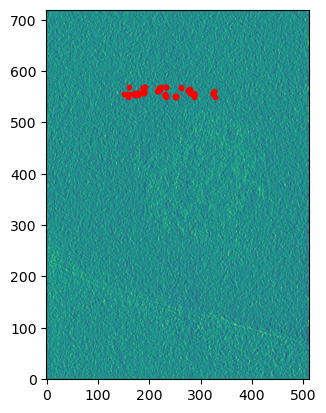

coords_filter.shape =  (225, 2)
3336 peak(s) too close to edge
Sampling from 225 peaks
Creating plot...


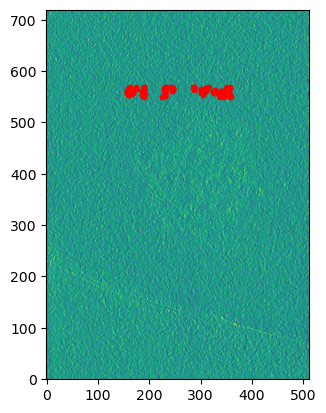

coords_filter.shape =  (93, 2)
2385 peak(s) too close to edge
Sampling from 93 peaks
Creating plot...


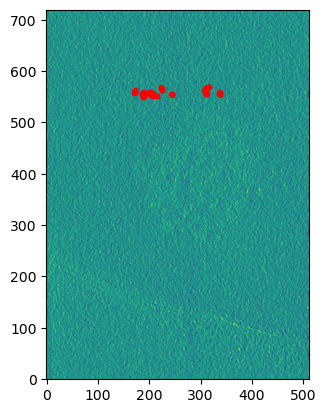

coords_filter.shape =  (141, 2)
2402 peak(s) too close to edge
Sampling from 141 peaks
Creating plot...


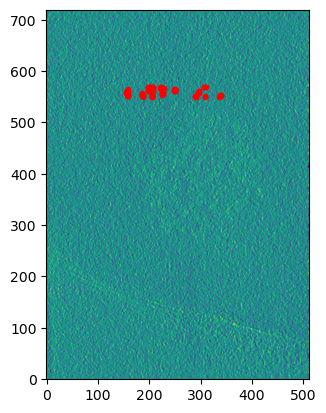

coords_filter.shape =  (179, 2)
2505 peak(s) too close to edge
Sampling from 179 peaks
Creating plot...


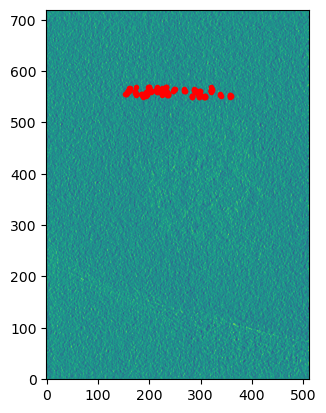

coords_filter.shape =  (117, 2)
2437 peak(s) too close to edge
Sampling from 117 peaks
Creating plot...


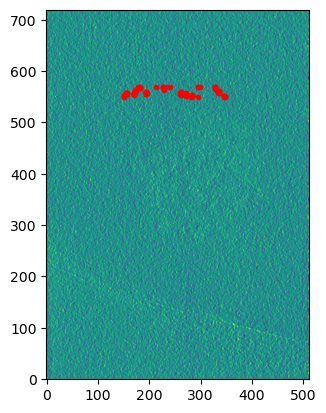

coords_filter.shape =  (109, 2)
2409 peak(s) too close to edge
Sampling from 109 peaks
Creating plot...


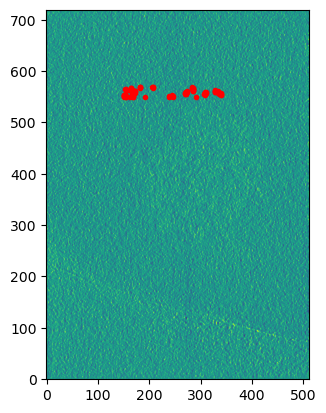

coords_filter.shape =  (157, 2)
2522 peak(s) too close to edge
Sampling from 157 peaks
Creating plot...


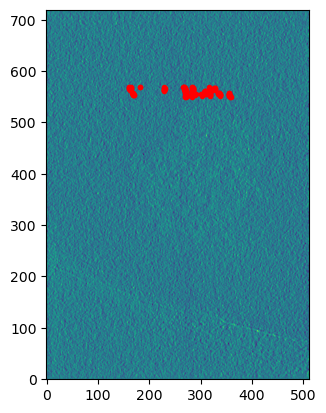

In [3]:
r=100
for i, zslice in enumerate(normtomo):
    img = zslice
    peaklist = np.load(f'data/peaklist/{session}/{tomo}/{i}_blinepeaklist.npy')
    gen_dists = GenerateDistributions(img,peaklist,r,rawtomoname,baseline=True,slice=i)

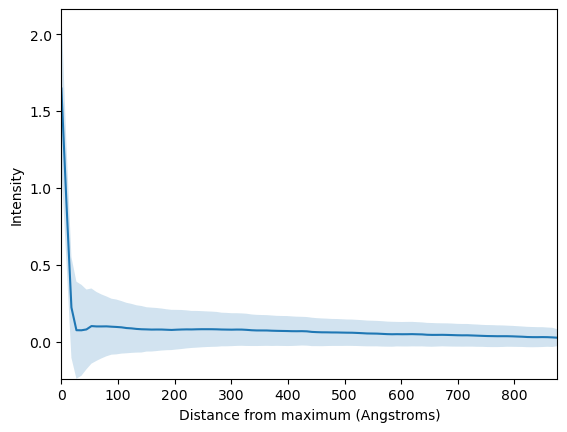

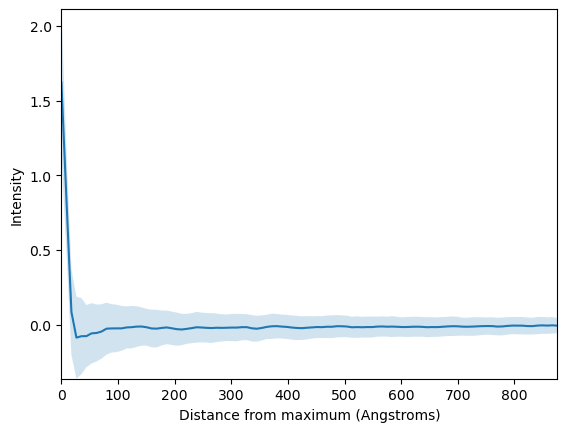

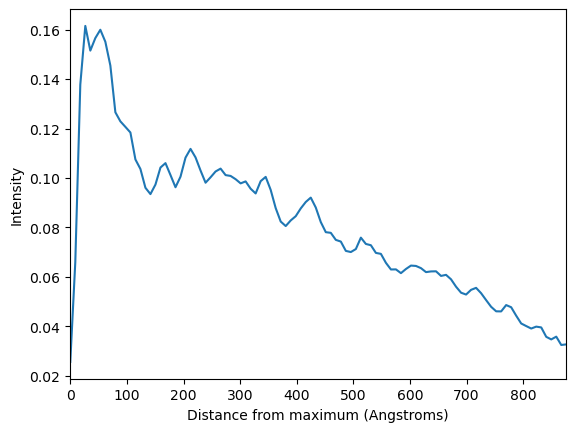

In [6]:
from lib.stacks_analysis import *

rawtomoname = 'raw/20220307_Baker/tomo8_b8_bp10000-500_s81-101.mrc' #can become sys.arg argument

plot1 = plotting(rawtomoname,baseline=False)
plot2 = plotting(rawtomoname,baseline=True)

dropletmean2 = plot1.dropletmean - plot2.dropletmean

r = dropletmean2.shape[0]
x_radav = np.arange(0,r,1)*8.848

plt.figure()
plt.plot(x_radav,dropletmean2)
# plt.fill_between(x_radav, dropletmean - dropletstd, dropletmean+dropletstd, alpha=0.2)
# plt.ylim([np.min(dropletmean-dropletstd),np.max(dropletmean+dropletstd)])
plt.xlim([0,np.max(x_radav)])
plt.xlabel('Distance from maximum (Angstroms)')
plt.ylabel('Intensity')
plt.show()

Normalising data...
Normalised.
(2273, 2)


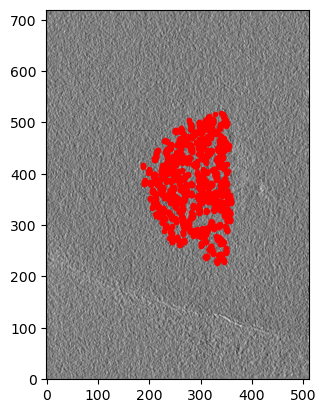

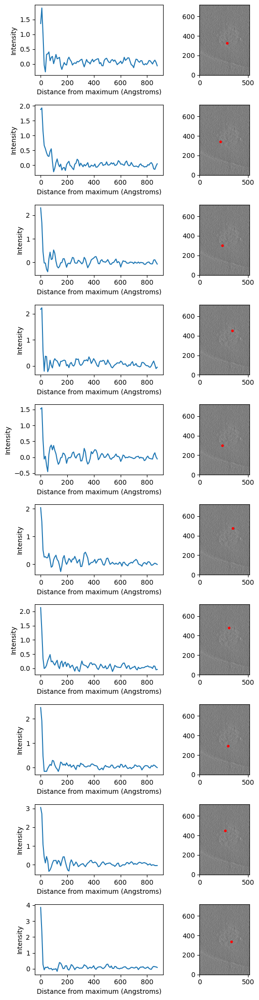

(206, 2)


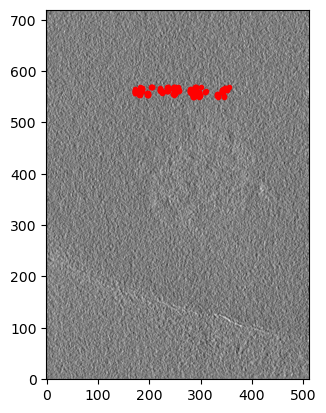

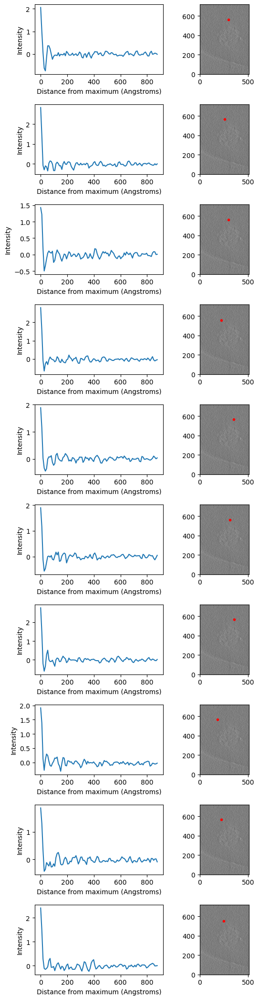

In [1]:
import mrcfile
import copy
from lib.analysis import *
import numpy as np
from skimage import color
import cv2

rawtomoname = 'raw/20220307_Baker/tomo8_b8_bp10000-500_s81-101.mrc'

rawtomoname = rawtomoname.split('.')[0]
session = rawtomoname.split('/')[-2]
tomo = rawtomoname.split('/')[-1]

with mrcfile.open(f'{rawtomoname}.mrc') as mrc:
    rawtomo = copy.deepcopy(mrc.data) * -1
    voxel_size = mrc.voxel_size
    vox_size = voxel_size.view((voxel_size.dtype[0], len(voxel_size.dtype.names)))
    vox_size = vox_size[0]
normtomo=normalise_data(rawtomo)

slice = 0
peaks = 10

radavlist = np.load(f'data/radavdata/radav/{session}/{tomo}/{slice}_radavlist.npy')
peaklist = np.load(f'data/peaklist/{session}/{tomo}/{slice}_filteredpeaklist.npy')
print(peaklist.shape)
y_peaks  = peaklist[:,0]
x_peaks = peaklist[:,1]

r = radavlist.shape[1]
x_radav = np.arange(0,r,1)*vox_size

plt.figure()
plt.imshow(normtomo[slice,:,:],cmap='gray')
plt.plot(x_peaks,y_peaks,'r.')
plt.gca().invert_yaxis()
plt.show()

fig, ax = plt.subplots(peaks, ncols=2, figsize=(6,2*peaks+1))
for i in range(peaks):
    ax[i,0].plot(x_radav, radavlist[i,:])
    ax[i,0].set_xlabel('Distance from maximum (Angstroms)')
    ax[i,0].set_ylabel('Intensity')

    ax[i,1].imshow(normtomo[slice,:,:],cmap='gray')
    ax[i,1].plot(x_peaks[i],y_peaks[i],'r.')
    ax[i,1].invert_yaxis()



fig.tight_layout()
plt.show()

radavlist = np.load(f'data/radavdata/radav/{session}/{tomo}/{slice}_blradavlist.npy')
peaklist = np.load(f'data/peaklist/{session}/{tomo}/{slice}_blfilteredpeaklist.npy')
print(peaklist.shape)
y_peaks  = peaklist[:,0]
x_peaks = peaklist[:,1]

r = radavlist.shape[1]
x_radav = np.arange(0,r,1)*vox_size

plt.figure()
plt.imshow(normtomo[slice,:,:],cmap='gray')
plt.plot(x_peaks,y_peaks,'r.')
plt.gca().invert_yaxis()
plt.show()

fig, ax = plt.subplots(peaks, ncols=2, figsize=(6,2*peaks+1))
for i in range(peaks):
    ax[i,0].plot(x_radav, radavlist[i,:])
    ax[i,0].set_xlabel('Distance from maximum (Angstroms)')
    ax[i,0].set_ylabel('Intensity')

    ax[i,1].imshow(normtomo[slice,:,:],cmap='gray')
    ax[i,1].plot(x_peaks[i],y_peaks[i],'r.')
    ax[i,1].invert_yaxis()



fig.tight_layout()
plt.show()






Normalising data...
Normalised.


/Users/eugene/opt/miniconda3/lib/python3.9/site-packages/skimage/color/colorlabel.py:113: UserWarning: Negative intensities in `image` are not supported
  return _label2rgb_overlay(label, image, colors, alpha, bg_label,
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

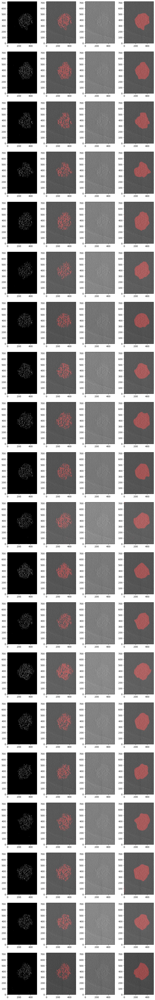

In [9]:
rawtomoname = 'raw/20220307_Baker/tomo8_b8_bp10000-500_s81-101.mrc' #can become sys.arg argument

rawtomoname = rawtomoname.split('.')[0]
session = rawtomoname.split('/')[-2]
tomo = rawtomoname.split('/')[-1]

maskname = f'data/masks/{session}/{tomo}_mask.npy'
coarsemapname = f'data/masks/{session}/{tomo}_coarsemap.npy'

with mrcfile.open(f'{rawtomoname}.mrc') as mrc:
    rawtomo = copy.deepcopy(mrc.data) * -1
    voxel_size = mrc.voxel_size
    vox_size = voxel_size.view((voxel_size.dtype[0], len(voxel_size.dtype.names)))
    vox_size = vox_size[0]
normtomo=normalise_data(rawtomo)


mask = np.load(maskname)
coarsemap = np.load(coarsemapname)

fig, ax = plt.subplots(nrows=len(mask),ncols=4, figsize=(12,4*len(mask)))
for i, slice in enumerate(mask):
    segmentname = f'data/segmentation/{session}/{tomo}/{i}_segments.npy'
    segment = np.load(segmentname)
    segment = segment>0
    norm_proj = cv2.normalize(normtomo[i,:,:], None, alpha=0, beta=1, norm_type=cv2.NORM_MINMAX, dtype=cv2.CV_32F)

    ax[i,0].imshow(slice, cmap='gray')
    ax[i,0].invert_yaxis()

    ax[i,1].imshow(color.label2rgb(segment,norm_proj,bg_label=0))
    ax[i,1].invert_yaxis()

    ax[i,2].imshow(normtomo[i,:,:],cmap='gray')
    ax[i,2].invert_yaxis()
    
    ax[i,3].imshow(color.label2rgb(coarsemap[i,:,:],norm_proj,bg_label=0))
    ax[i,3].invert_yaxis()

# fig.tight_layout()

plt.show()


